In [1]:
### Identify Marker genes for the clusters

# Load Libraries

In [2]:
import scanpy as sc
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scanorama
import os
import multiprocessing
import random
import time
import git
import sys
from datetime import date
from matplotlib.backends.backend_pdf import PdfPages

# Load Data

## Configurations

### Technical configurations

In [3]:
multiprocessing.cpu_count()  ### total amount of cpu on the used core

64

In [4]:
len(os.sched_getaffinity(0)) ### amount of available cpus

24

In [5]:
sc.settings.n_jobs   # default number of CPUs to use for parallel computing

1

In [6]:
sc.settings.max_memory  # maximum memory to use in GB

15

In [7]:
random.seed(7)

In [8]:
ncore = '24'

In [9]:
random_state_var = 7

In [10]:
n_jobs_var = 24

In [11]:
os.environ["OMP_NUM_THREADS"] = ncore
os.environ["OPENBLAS_NUM_THREADS"] = ncore
os.environ["MKL_NUM_THREADS"] = ncore
os.environ["VECLIB_MAXIMUM_THREADS"] = ncore
os.environ["NUMEXPR_NUM_THREADS"] = ncore

In [12]:
sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 0

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.7.6
scanpy      1.8.1
sinfo       0.3.4
-----
PIL                 8.3.1
annoy               NA
anyio               NA
attr                21.2.0
babel               2.9.1
backcall            0.2.0
beta_ufunc          NA
binom_ufunc         NA
brotli              NA
certifi             2021.05.30
cffi                1.14.6
chardet             4.0.0
charset_normalizer  2.0.0
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
decorator           5.0.9
defusedxml       

### Parameters

In [13]:
data_path = '../data/current'

In [14]:
data_path

'../data/current'

In [15]:
variant = 'V1_Scanorama_Singlets'

In [16]:
variants = [variant]

In [17]:
result_path = '../results/current'

In [18]:
### Dataset storing annotations

In [19]:
#saved_annotations = pd.read_csv(result_path + '/B-Analysis/saved_annotations.csv')

In [20]:
save_path = '_B5_' + variant + '_Annotations.pdf'

## Meta-Data File

In [21]:
dataset_path = data_path  +"/preprocessed-data/meta-data/Mapping_Hashtag_Sample.csv"
library_hashtag_mapping = pd.read_csv(dataset_path) 
print('Last modified' + time.ctime(os.path.getmtime(dataset_path)))

Last modifiedThu Sep  2 13:17:03 2021


In [22]:
#library_hashtag_mapping

## Clustered data from B3 Scanorama

In [23]:
anndata_dict = dict.fromkeys(variants)

In [24]:
for key in anndata_dict:
    dataset_path = data_path + '/analysis/B/B3_Integrated_Singlet_processed_rna.h5ad'
    
    print(dataset_path)
    print('Last modified' + time.ctime(os.path.getmtime(dataset_path)))
    
    adata_orig = sc.read_h5ad(dataset_path)
    anndata_dict[key]= adata_orig # save anndata in dictionary
    
    anndata_dict[key].uns['data_load_time'] = time.ctime(os.path.getmtime(dataset_path))  # save the last modified timestamp of the data loaded
    anndata_dict[key].uns['data_load_name'] = dataset_path # save the data path of the data loaded 
    

../data/current/analysis/B/B3_Integrated_Singlet_processed_rna.h5ad
Last modifiedMon Mar  4 15:18:28 2024


In [25]:
### Short data check

In [26]:
# anndata_dict['V1_All']  # cells have been filtered only on singlets

In [27]:
anndata_dict[key].X.sum(axis=1) # data was normalized and log-transformed, scanorama transformed - alternative: scaled + regressed - not scanorama base


array([-105.86096 ,    9.41081 , -116.85063 , ...,  249.01207 ,
        106.5417  ,   49.693195], dtype=float32)

In [28]:
anndata_dict[key].raw.X.sum(axis=1) # no raw object in Scanormaa variant

matrix([[ 3947.],
        [ 5870.],
        [ 3888.],
        ...,
        [ 4079.],
        [17619.],
        [ 3231.]], dtype=float32)

### Identify genes that are different across clusters

In [29]:
anndata_dict[key].obs.columns

Index(['nCount_HTO', 'nFeature_HTO', 'nCount_RNA', 'nFeature_RNA',
       'percent_mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin',
       'HTO_classification', 'HTO_classification.global', 'hash.ID',
       'HTO_classification_final', 'name', 'library', 'id', 'read', 'pattern',
       'sequence', 'feature_type', 'Unnamed: 7', 'in_sample', 'display_name',
       'group_x', 'HTO_Doublet_Classification', 'doublet_score',
       'predicted_doublet', 'A5_scrublet_predicted_doublet_lib0.1',
       'A5_scrublet_doublet_score_lib_0.1',
       'A5_scrublet_predicted_doublet_lib0.2',
       'A5_scrublet_doublet_score_lib_0.2',
       'A5_scrublet_predicted_doublet_lib', 'A5_scrublet_doublet_score_lib',
       'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'valid_cell_filter_dying', 'valid_cell_filter_doublet',
       'A7_PCA_50_10_neighbors_cluster', 'A7_PCA_100_10_neighbors_cluster',
       'A7_PCA_100_50_neighbors_cluster', 'A7_PCA_500_50_neighbors_c

In [30]:
preferred_clustering = 'B2_Scanorama_Singlet_rb_mt_cluster'

In [31]:
#### Adapt to remove rb & mt genes

In [32]:
for key in anndata_dict:
    anndata_dict[key]  = anndata_dict[key] [:,np.logical_and(anndata_dict[key].var['rb'] == False , anndata_dict[key].var['mt'] == False)]

In [33]:
#### Calculate top genes per cluster

In [34]:
# anndata_dict

In [35]:
for key in anndata_dict:
    sc.tl.rank_genes_groups(anndata_dict[key], groupby=preferred_clustering, method='wilcoxon', layer = 'A6_normalized_log', use_raw = False)
    print('Library: ' + key)
    ### only display top3 different genes for each cluster
    ### TBD: check out which scale is used
    
    

Trying to set attribute `.uns` of view, copying.


Library: V1_Scanorama_Singlets


In [36]:
#### Generate cluster cell type data frame

In [37]:
cluster_cell_types = pd.DataFrame(columns=['cluster', 'cell_type', 'cluster_cell_type'])

In [38]:
cluster_cell_types['cluster_cell_type'] = pd.unique(anndata_dict[key].obs[ 'cluster_cell_type_Scanorama']).astype('string')

In [39]:
cluster_cell_types['cluster'] = cluster_cell_types['cluster_cell_type'].str.extract('(.*_)')

In [40]:
cluster_cell_types['cluster'] = cluster_cell_types['cluster'].str.replace('_', '',1)

In [41]:
cluster_cell_types['cell_type'] = cluster_cell_types['cluster_cell_type'].str.extract('(_.*)')

In [42]:
cluster_cell_types['cell_type'] = cluster_cell_types['cell_type'].str.replace('_', '',1)

In [43]:
cluster_cell_types

,cluster,cell_type,cluster_cell_type
0,8,B-cell,8_B-cell
1,9Monocytes - CD16_,Monocytes - CD16_FCGR3A,9_Monocytes - CD16_FCGR3A
2,5,T-cell-CD4,5_T-cell-CD4
3,0,T-cell-CD4,0_T-cell-CD4
4,16,Plasma Blast,16_Plasma Blast
5,1,T-cell-CD8,1_T-cell-CD8
6,6,Monocytes - CD14,6_Monocytes - CD14
7,2,T-cell-CD4,2_T-cell-CD4
8,4,Monocytes - CD14,4_Monocytes - CD14
9,14,Other,14_Other


In [44]:
### Save top genes per cluster in dataframe

In [45]:
top_genes = pd.DataFrame(columns=['cluster', 'gene', 'rank'])

In [46]:
top_genes_all = pd.DataFrame(columns=['cluster', 'gene', 'rank'])

In [47]:
for i, j in cluster_cell_types.iterrows():
    # print(i)
    cluster = i
    cluster = str(cluster)
    print(cluster)
    
    top_genes['gene'] = anndata_dict[key].uns['rank_genes_groups']['names'][cluster][0:150]   # genes ranked according to score for this cluster: 0
    top_genes['cluster'] = cluster
    top_genes['rank'] = top_genes.index
    
    top_genes_all = top_genes_all.append(top_genes)
    
    # print(anndata_dict[key].uns['rank_genes_groups']['names'][cluster][0:50])

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18


In [48]:
top_genes_all['cluster'] = top_genes_all['cluster'].astype('string')

In [49]:
top_genes_all = top_genes_all.merge(cluster_cell_types,left_on='cluster', right_on='cluster')

In [50]:
top_genes_all

,cluster,gene,rank,cell_type,cluster_cell_type
0,0,LTB,0,T-cell-CD4,0_T-cell-CD4
1,0,IL7R,1,T-cell-CD4,0_T-cell-CD4
2,0,RGCC,2,T-cell-CD4,0_T-cell-CD4
3,0,ITGB1,3,T-cell-CD4,0_T-cell-CD4
4,0,CD69,4,T-cell-CD4,0_T-cell-CD4
...,...,...,...,...,...
2545,18,RAB30,145,Megakaryocytes,18_Megakaryocytes
2546,18,CD36,146,Megakaryocytes,18_Megakaryocytes
2547,18,HIST1H2BN,147,Megakaryocytes,18_Megakaryocytes
2548,18,EIF4E,148,Megakaryocytes,18_Megakaryocytes


In [51]:
top_genes_all.to_csv(result_path + '/B-Analysis/B5_Scanorama_Singlet_Cluster_Top_Genes_VNLog.csv')

### Plot expressions of top genes

In [52]:
anndata_dict[key].layers

Layers with keys: A6_normalized, A6_normalized_log

In [53]:
save_path

'_B5_V1_Scanorama_Singlets_Annotations.pdf'

In [54]:
sc.settings.figdir = 'figures/Supplementary_Figures/'

In [55]:
pp = PdfPages('figures/Supplementary_Figures/B5_dotplot_top_genes_per_cluster' + save_path)

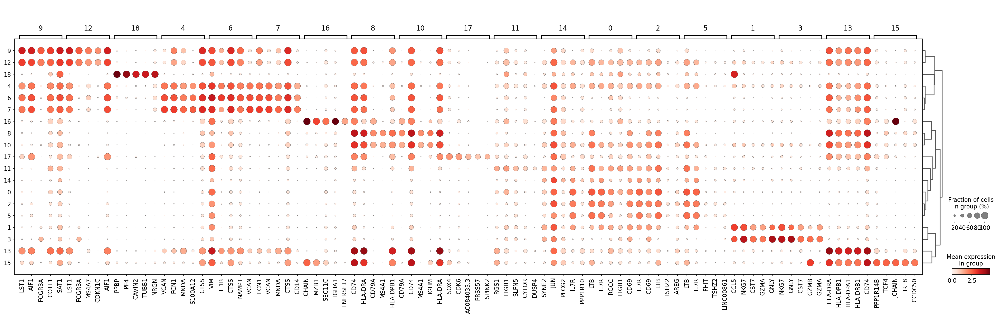

In [56]:
fig, (ax1) = plt.subplots(1, 1, figsize=(35,10), gridspec_kw={'wspace':0.5})
ax_plot = sc.pl.rank_genes_groups_dotplot(anndata_dict[key], n_genes=5, ax = ax1, show = False,  use_raw = False , layer = 'A6_normalized_log')
pp.savefig()

In [57]:
pp.close()

In [60]:
#pp = PdfPages('figures/B5_Cluster_DE_Genes/B5_extended_dotplot_top_genes_per_cluster' + save_path)

In [61]:
#for i, j in cluster_cell_types.iterrows():
    # print(i)
#    cluster = i
#    cluster = str(cluster)
    # print(cluster)
    
#    fig, (ax1) = plt.subplots(1, 1, figsize=(20,7), gridspec_kw={'wspace':0.5})
#    ax_plot1  = sc.pl.rank_genes_groups_dotplot(anndata_dict[key], n_genes=50,  groups=[cluster], ax = ax1, show = False, use_raw = False , layer = 'A6_normalized_log')
    
#    pp.savefig()

In [63]:
#pp.close()

In [64]:
#### Plot heatmap without gene labels but more genes (10 per cluster)

In [65]:
#for key in anndata_dict:
#    print('Library: ' + key)
#    sc.pl.rank_genes_groups_heatmap(anndata_dict[key], n_genes=10, use_raw=True, swap_axes=True, show_gene_labels=False,
#                                vmin=-3, vmax=3, cmap='bwr')
    ### only display top10 different genes for each cluster
    ### TBD: check out which scale is used


In [66]:
### TBD: would also be interesting to see this per sample?/ group?

### Plot UMAP of total counts with log-normalized values

In [67]:
used_umap_list = { 'V2': 'X_umapB2_Scanorama_Singlet_rb_mt'}

In [68]:
used_neighbors_key_list = { 'V2':'B2_Scanorama_Singlet_rb_mt'} 

In [69]:
save_key = '_key_metrics'

In [70]:
save_plot = save_key + save_path

In [71]:
### Plot the resulting clusters for each library

sc.set_figure_params(dpi=100, color_map = 'viridis_r')
plt.rcParams['figure.figsize'] = [20, 20] 

for key in anndata_dict:
    print('Library: ' + key)
    
    for umap in used_umap_list:
        used_umap = used_umap_list[umap]
        used_neighbors_key = used_neighbors_key_list[umap]
        print(used_umap)
        anndata_dict[key].obsm['X_umap'] = anndata_dict[key].obsm[used_umap]
        
        sc.pl.umap(anndata_dict[key], color=['B2_Scanorama_Singlet_rb_mt_cluster','total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'cell_type_Scanorama', 'library_id'], s = 15, ncols = 2, neighbors_key = used_neighbors_key, use_raw = False , layer = 'A6_normalized_log', save = save_plot)
        #sc.pl.umap(anndata_dict[key], color=['ALL_PCA_50_10_neighbors_cluster','ALL_PCA_100_10_neighbors_cluster','library_id', 'group', 'HTO_classification_final', 'total_counts', 'HTO_classification.global',  'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib0.2'], s = 10, ncols = 2, neighbors_key = used_neighbors_key)
    
    print('')
    ### Interesting parameters
    # use_raw = true - what to use for coloring with gene expression; default true if layer is not provided
    # layer = name of layer that should be plotted
    # neighbors_key = where to look for neighbors connectivities
    
    print ('')

Library: V1_Scanorama_Singlets
X_umapB2_Scanorama_Singlet_rb_mt
